[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/pinecone-io/examples/blob/master/learn/generation/langchain/handbook/07-langchain-tools.ipynb) [![Open nbviewer](https://raw.githubusercontent.com/pinecone-io/examples/master/assets/nbviewer-shield.svg)](https://nbviewer.org/github/pinecone-io/examples/blob/master/learn/generation/langchain/handbook/07-langchain-tools.ipynb)

#### [LangChain Handbook](https://www.pinecone.io/learn/series/langchain/)

# Building Tools

[LLM agents](https://www.pinecone.io/learn/series/langchain/langchain-agents/) are one of the most powerful and fascinating technologies to come out of the huge explosion of LLMs since the introduction of ChatGPT.

Using agents we are able to give LLMs access to tools. These tools give us an essentially infinite number of possibilities as they allow us to search the web, do maths, run code, and much more.

There are many prebuilt tools available from LangChain, but in many real world scenarios we need to build custom tools to fit the requirements of our use-cases.

In this notebook, we will explore how we can build custom tools for agents in LangChain. Starting with simple math functions to give us an idea of how it works, before moving on to using *other* ML models to give us even more abilities like describing images.


---

**🚨 Note: This notebook uses a local ML model. Runtime can be improved by using a CUDA-enabled GPU. If running on Google Colab you can set this by clicking _Runtime_ in the toolbar above, click _Change runtime time > Hardware accelerator > GPU_.**

---


To begin, we must install the prerequisite libraries that we will be using in this notebook.

In [1]:
!pip install -qU \
  langchain==0.3.25 \
  langchain-openai==0.3.22 \
  transformers==4.52.4


[notice] A new release of pip is available: 23.1.2 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


Let's begin taking a look at how we can build custom tools. We'll start with some simple examples so we can understand the _flow_ of the tool building process.

## Simple Calculator Tool

We will begin with a very simple *circumference* calculating tool that we will define like so:

In [2]:
from langchain_core.tools import tool
from math import pi

@tool
def calculate_circumference(radius: float) -> float:
    """Calculate the circumference of a circle given its radius.
    Args:
        radius: The radius of the circle in units
    Returns:
        The circumference of the circle in the same units
    """
    return 2 * pi * radius


When defining a tool like this using the `@tool` decorator, we simply define a function with type hints. The decorator automatically handles the tool interface for us, making it much simpler than the old BaseTool approach.

We need to initialize the agent LLM. For the LLM we will use `gpt-4o-mini` from OpenAI, to use this you need an [OpenAI API key](https://platform.openai.com).

_Note: Using the OpenAI API costs money, the examples below are not very large so the costs should not be significant._

In [3]:
import os
from getpass import getpass

os.environ["OPENAI_API_KEY"] = os.getenv("OPENAI_API_KEY") \
    or getpass("Enter your OpenAI API key: ")

OPENAI_API_KEY = os.getenv("OPENAI_API_KEY")

In [4]:
from langchain_openai import ChatOpenAI

# initialize LLM (we use ChatOpenAI because we'll later define a `chat` agent)
llm = ChatOpenAI(
    openai_api_key=OPENAI_API_KEY,
    model_name="gpt-4o-mini",
    temperature=0.0,
)


Now we initialize the agent itself. To use the circumference tool we defined above we must add it to a list that we then pass to `llm.bind_tools()`:

In [5]:
from langchain_core.prompts import ChatPromptTemplate, MessagesPlaceholder
from langchain_core.messages import HumanMessage, AIMessage, ToolMessage



prompt = ChatPromptTemplate.from_messages([
    ("system", "you're a helpful assistant"),
    MessagesPlaceholder(variable_name="chat_history"),
    ("human", "{input}"),
    MessagesPlaceholder(variable_name="agent_scratchpad"),
])

# Define your tools list
tools = [calculate_circumference]

class CustomAgentExecutor:
    def __init__(
        self, 
        prompt: ChatPromptTemplate,
        tools: list,
        llm: ChatOpenAI,
        max_iterations: int = 3
    ):
        self.chat_history = []
        self.max_iterations = max_iterations
        self.name2tool = {tool.name: tool.func for tool in tools}
        self.agent = (
            {
                "input": lambda x: x["input"],
                "chat_history": lambda x: x["chat_history"],
                "agent_scratchpad": lambda x: x.get("agent_scratchpad", [])
            }
            | prompt
            | llm.bind_tools(tools, tool_choice="auto")
        )

    def invoke(self, input: str, verbose: bool = False) -> dict:
        count = 0
        agent_scratchpad = []
        
        while count < self.max_iterations:
            # Get tool call from agent
            response = self.agent.invoke({
                "input": input,
                "chat_history": self.chat_history,
                "agent_scratchpad": agent_scratchpad
            })
            if verbose:
                print(f"Response: {response}")

            # Add response to scratchpad
            agent_scratchpad.append(response)
            
            # If no tool calls, we have our answer
            if not response.tool_calls:
                self.chat_history.extend([
                    HumanMessage(content=input),
                    AIMessage(content=response.content)
                ])
                return {"answer": response.content}
            
            # Execute tool
            tool_call = response.tool_calls[0]
            tool_name = tool_call["name"]
            tool_args = tool_call["args"]
            
            # Find and execute the tool
            tool_output = self.name2tool[tool_name](**tool_args)
            
            # Add tool output to scratchpad
            agent_scratchpad.append(
                ToolMessage(
                    content=str(tool_output),
                    tool_call_id=tool_call["id"]
                )
            )
            
            count += 1
        
        # Update chat history with final result
        self.chat_history.extend([
            HumanMessage(content=input),
            AIMessage(content=str(tool_output))
        ])
        
        return {"answer": str(tool_output)}



Now let's try and ask it to calculate the circumference of a circle:

In [6]:
sys_msg = """Assistant is a large language model trained by OpenAI.

Assistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.

Assistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.

For mathematical calculations, Assistant always uses its provided tools to ensure perfect accuracy and consistency. Even for simple calculations, Assistant relies on these tools rather than performing calculations itself, as this guarantees precise, verifiable results every time.

Overall, Assistant is a powerful system that can help with a wide range of tasks and provide valuable insights and information on a wide range of topics. Whether you need help with a specific question or just want to have a conversation about a particular topic, Assistant is here to assist.
"""

# Update the prompt with new system message
prompt = ChatPromptTemplate.from_messages([
    ("system", sys_msg),
    MessagesPlaceholder(variable_name="chat_history"),
    ("human", "{input}"),
    ("placeholder", "{agent_scratchpad}"),
])

agent_executor = CustomAgentExecutor(
    prompt=prompt,
    tools=tools,
    llm=llm,
    max_iterations=3
)

In [7]:
result = agent_executor.invoke("can you calculate the circumference of a circle that has a radius of 7.81mm", verbose=True)
result

Response: content='' additional_kwargs={'tool_calls': [{'id': 'call_hyBRWdrsII9UQ1wxFeFD5WyM', 'function': {'arguments': '{"radius":7.81}', 'name': 'calculate_circumference'}, 'type': 'function'}], 'refusal': None} response_metadata={'token_usage': {'completion_tokens': 19, 'prompt_tokens': 358, 'total_tokens': 377, 'completion_tokens_details': {'accepted_prediction_tokens': 0, 'audio_tokens': 0, 'reasoning_tokens': 0, 'rejected_prediction_tokens': 0}, 'prompt_tokens_details': {'audio_tokens': 0, 'cached_tokens': 0}}, 'model_name': 'gpt-4o-mini-2024-07-18', 'system_fingerprint': 'fp_34a54ae93c', 'id': 'chatcmpl-BqcaxU4yEogJ6Tb5cNS24gXEsxds5', 'service_tier': 'default', 'finish_reason': 'tool_calls', 'logprobs': None} id='run--24128425-99f7-4549-bd2c-46cf6fad2e77-0' tool_calls=[{'name': 'calculate_circumference', 'args': {'radius': 7.81}, 'id': 'call_hyBRWdrsII9UQ1wxFeFD5WyM', 'type': 'tool_call'}] usage_metadata={'input_tokens': 358, 'output_tokens': 19, 'total_tokens': 377, 'input_tok

{'answer': 'The circumference of a circle with a radius of 7.81 mm is approximately 49.07 mm.'}

We can see that cirumference tool has indeed been used. When `verbose=True` we see the response outputs, and can see the following contained within:

```
'tool_calls': [{
    'id': 'call_Q8tkgTKiEV5cPioI397n7Hfo', 
    'function': {
        'arguments': '{"radius":7.81}', 
        'name': 'calculate_circumference'
    }, 
    'type': 'function'
}]
```

Let's now verify that the answer is correct:

In [8]:
(7.81 * 2) * pi

49.071677249072565

## Tools with Multiple Parameters

Tools can also handle multiple parameters, let's try and build a Pythagoras tool. The tool helps us calculate the hypotenuse of a triangle given a combination of side lengths and/or angles.

In [9]:
from typing import Optional
from math import sqrt, cos, sin

desc = (
    "use this tool when you need to calculate the length of an hypotenuse "
    "given one or two sides of a triangle and/or an angle (in degrees). "
    "To use the tool you must provide at least two of the following parameters "
    "['adjacent_side', 'opposite_side', 'angle']."
)

@tool
def calculate_hypotenuse(
    adjacent_side: Optional[float] = None,
    opposite_side: Optional[float] = None,
    angle: Optional[float] = None
) -> float:
    """Calculate the hypotenuse of a triangle given sides and/or angle."""
    if adjacent_side and opposite_side:
        return sqrt(float(adjacent_side)**2 + float(opposite_side)**2)
    elif adjacent_side and angle:
        return adjacent_side / cos(float(angle))
    elif opposite_side and angle:
        return opposite_side / sin(float(angle))
    else:
        return "Could not calculate the hypotenuse. Need two or more parameters."

tools = [calculate_hypotenuse]

In [10]:
# Update the prompt with new system message
prompt = ChatPromptTemplate.from_messages([
    ("system", sys_msg),
    MessagesPlaceholder(variable_name="chat_history"),
    ("human", "{input}"),
    MessagesPlaceholder(variable_name="agent_scratchpad"),
])


agent_executor = CustomAgentExecutor(
    prompt=prompt,
    tools=tools,
    llm=llm,
    max_iterations=3
)

In [11]:
# Correct:
agent_executor.invoke(
    "If I have a triangle with two sides of length 51cm and 34cm, what is the length of the hypotenuse?",
    verbose=True
)

Response: content='' additional_kwargs={'tool_calls': [{'id': 'call_4fSoBqDo9klaj8SkV5UTmbwY', 'function': {'arguments': '{"adjacent_side":51,"opposite_side":34}', 'name': 'calculate_hypotenuse'}, 'type': 'function'}], 'refusal': None} response_metadata={'token_usage': {'completion_tokens': 25, 'prompt_tokens': 381, 'total_tokens': 406, 'completion_tokens_details': {'accepted_prediction_tokens': 0, 'audio_tokens': 0, 'reasoning_tokens': 0, 'rejected_prediction_tokens': 0}, 'prompt_tokens_details': {'audio_tokens': 0, 'cached_tokens': 0}}, 'model_name': 'gpt-4o-mini-2024-07-18', 'system_fingerprint': 'fp_34a54ae93c', 'id': 'chatcmpl-BqcaydOG0TPQiY4Hgfm4mhVP6eON5', 'service_tier': 'default', 'finish_reason': 'tool_calls', 'logprobs': None} id='run--4a346c45-59ed-44e1-a601-9a29e9e70b54-0' tool_calls=[{'name': 'calculate_hypotenuse', 'args': {'adjacent_side': 51, 'opposite_side': 34}, 'id': 'call_4fSoBqDo9klaj8SkV5UTmbwY', 'type': 'tool_call'}] usage_metadata={'input_tokens': 381, 'output_

{'answer': 'The length of the hypotenuse of the triangle with sides of length 51 cm and 34 cm is approximately 61.29 cm.'}

## More Advanced Tool Usage

We just built two quick examples of very simple tools. In most scenarios we'd probably like to do something a little more complex — so let's build something more interesting.

We will take inspiration from the [Hugging GPT paper](https://arxiv.org/pdf/2303.17580), where others describe what is essentially a ensemble of open source models trained for different tasks, that are controlled by a LLM. In our example we will take one of the existing open source models that is able to caption images called `Salesforce/blip-image-captioning-large`.

We initialize the model like so:

In [12]:
import torch
from transformers import BlipProcessor, BlipForConditionalGeneration

hf_model = "Salesforce/blip-image-captioning-large"
device = 'cuda' if torch.cuda.is_available() else 'cpu'

processor = BlipProcessor.from_pretrained(hf_model)
model = BlipForConditionalGeneration.from_pretrained(hf_model).to(device)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


To generate a caption for an image we need to first download it and open it as a PIL image object. We do this like so:

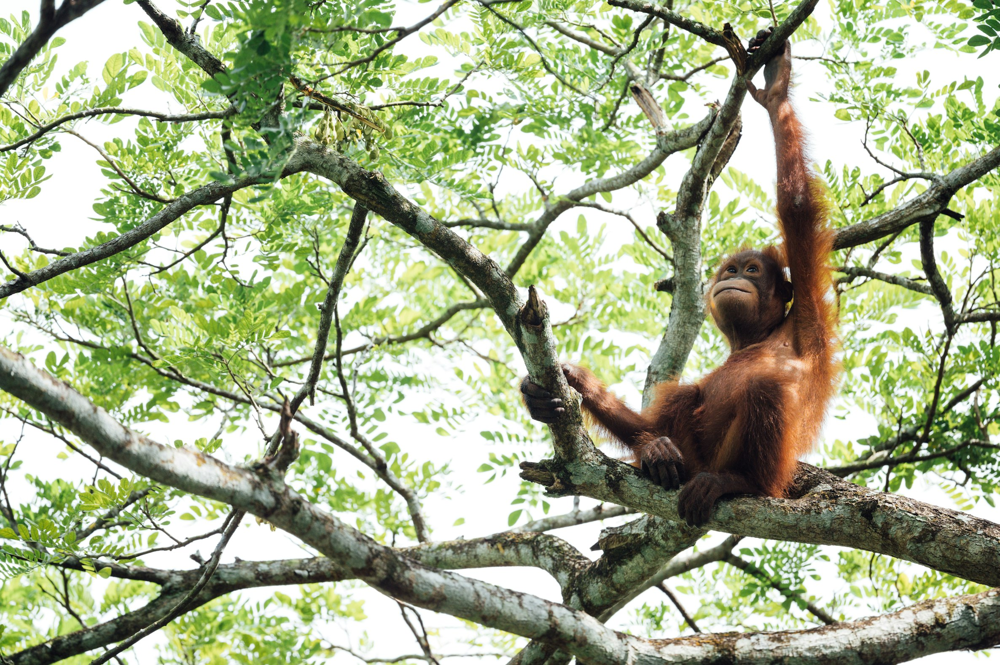

In [13]:
import requests
from PIL import Image

img_url = 'https://images.unsplash.com/photo-1616128417859-3a984dd35f02?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2372&q=80' 
image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')
image

Now we process the image using the model `processor` and generate the caption using `model.generate`:

In [14]:
# unconditional image captioning
inputs = processor(image, return_tensors="pt").to(device)

out = model.generate(**inputs, max_new_tokens=20)
print(processor.decode(out[0], skip_special_tokens=True))

there is a monkey that is sitting in a tree


> 🤓 It's wrong, that's an orangutan, not a monkey. Monkeys typically have tails and orangutans are a type of great ape. But close enough I suppose!

We can use this process as the logic for our new image captioning tool. Let's first define the tool class.

In [15]:
desc = (
    "use this tool when given the URL of an image that you'd like to be "
    "described. It will return a simple caption describing the image."
)

@tool
def caption_image(url: str) -> str:
    """Generate a caption for an image given its URL."""
    image = Image.open(requests.get(url, stream=True).raw).convert('RGB')
    inputs = processor(image, return_tensors="pt").to(device)
    out = model.generate(**inputs, max_new_tokens=20)
    return processor.decode(out[0], skip_special_tokens=True)

tools = [caption_image]

Let's reinitialize our agent prompt and set the `tools` attribute to reflect the new tool list:

In [16]:
sys_msg = """Assistant is a large language model trained by OpenAI.

Assistant is designed to be able to assist with a wide range of tasks, from answering simple questions to providing in-depth explanations and discussions on a wide range of topics. As a language model, Assistant is able to generate human-like text based on the input it receives, allowing it to engage in natural-sounding conversations and provide responses that are coherent and relevant to the topic at hand.

Assistant is constantly learning and improving, and its capabilities are constantly evolving. It is able to process and understand large amounts of text, and can use this knowledge to provide accurate and informative responses to a wide range of questions. Additionally, Assistant is able to generate its own text based on the input it receives, allowing it to engage in discussions and provide explanations and descriptions on a wide range of topics.

Overall, Assistant is a powerful system that can help with a wide range of tasks and provide valuable insights and information on a wide range of topics. Whether you need help with a specific question or just want to have a conversation about a particular topic, Assistant is here to assist.
"""

# Update the prompt with new system message
prompt = ChatPromptTemplate.from_messages([
    ("system", sys_msg),
    MessagesPlaceholder(variable_name="chat_history"),
    ("human", "{input}"),
    MessagesPlaceholder(variable_name="agent_scratchpad"),
])

agent_executor = CustomAgentExecutor(
    prompt=prompt,
    tools=tools,
    llm=llm,
    max_iterations=3
)

In [17]:
agent_executor.invoke(f"What does this image show?\n{img_url}")

{'answer': 'The image shows a monkey sitting in a tree.'}

Let's try some more.

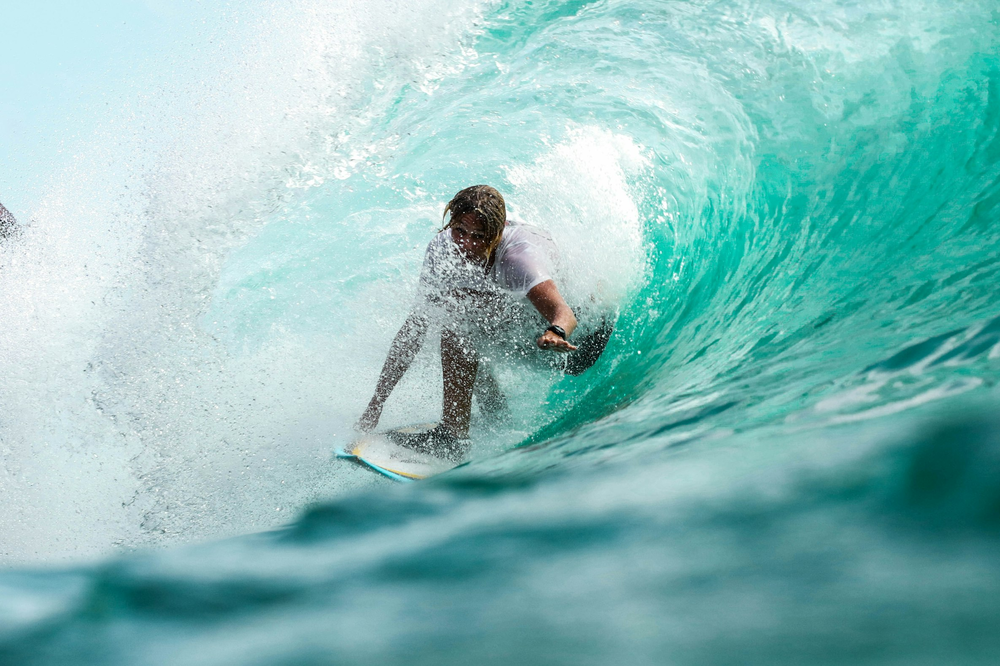

In [18]:
img_url = "https://images.unsplash.com/photo-1502680390469-be75c86b636f?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2370&q=80"
image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')
image

In [19]:
agent_executor.invoke(f"what is in this image?\n{img_url}")

{'answer': 'The image shows a surfer riding a wave in the ocean on a clear day.'}

> 🤓 Also a type of great ape, as it turns out!

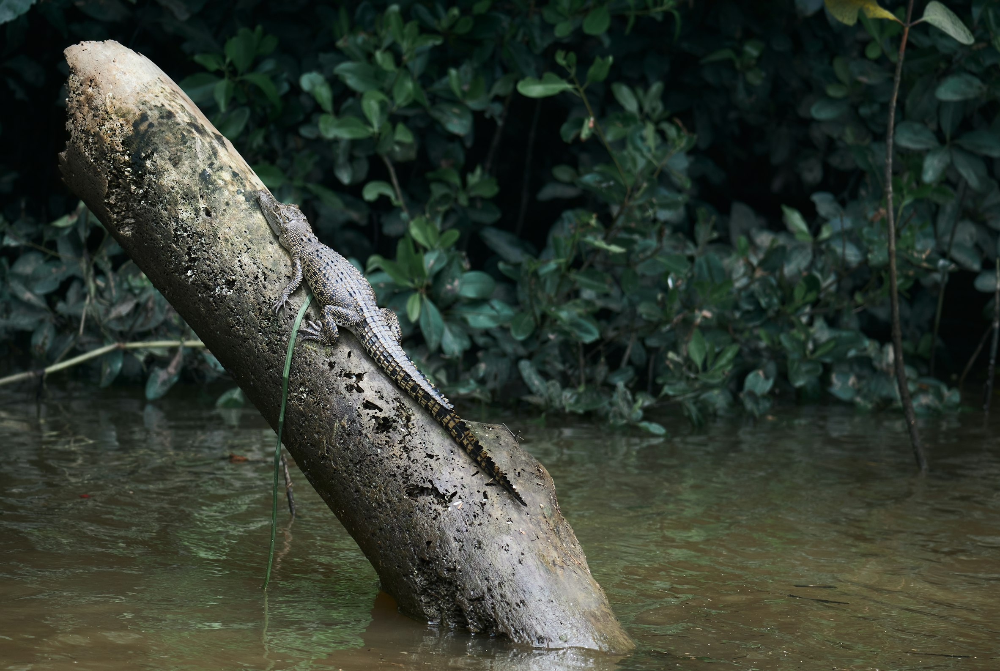

In [20]:
img_url = "https://images.unsplash.com/photo-1680382948929-2d092cd01263?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2365&q=80"
image = Image.open(requests.get(img_url, stream=True).raw).convert('RGB')
image

In [21]:
agent_executor.invoke(f"what is in this image?\n{img_url}")

{'answer': 'The image shows a lizard sitting on a tree branch above the water.'}

> 🤓 Again, not quiet right, that's either a baby alligator or crocodile - neither of which are lizards - but not bad!

Naturally, we can build much more complex tools, or simply add new tools to our agents.